In [1]:
import numpy as np
from scipy.integrate import solve_ivp
import matplotlib.pyplot as plt
tfont = {'fontname':'Times New Roman'}


In [7]:
# Define the function F(x)
def F(x):
    return 1 / (1 + np.exp(x))

# Define the Heaviside step function
def heav(x):
    return 1.0 * (x > 0)

## Parameters

TOLERANCE=10

#Excitability
Eseek=1
Ebinge=10.5 
Estop=10.5
#Estr=1.84 
Estr=1.84
Eaps=1
Esetp=6

#Tau
seekTAU=1
bingeTAU=1
stopTAU=1
strTAU=1 

#Drive
seekDRIVE=0.01 
bingeDRIVE=0.5
stopDRIVE=0.5
strDRIVE=-1.4 

#Synaptic Weights
spTOseek=5
seekTOstr=10
apsTOseek=1
vtaTOstr=1
binTOstr=1
binTOstop=1
stopTObin=2
seekTObin=3
spTOstop=1

#Durations
nsSTART=10
nsDUR=0
nsTOstop=0
strCAP=1
daFACTOR=0.15
vtaSLOPE=4

# Initial conditions [seek, binge, stop, STR, alcohol]
y0 = [0, 0.2, 0.2, 0.3, 0] 

# Time span
t_span = (0, 50)



In [8]:
# Define the system of ODEs
def ode_system(t, y):
    seek, binge, stop, stri, ALCOHOL = y
    
    setp = 1 - F(Esetp * (ALCOHOL - TOLERANCE))
    vta = F(vtaSLOPE * (t - (TOLERANCE/3)))
    aps = Eaps * stri
    ns = heav(t - nsSTART) - heav(t - nsSTART + nsDUR)
    
    dseek_dt = (-seek + F(Eseek * (spTOseek * setp - apsTOseek * aps - seekDRIVE))) / seekTAU
    dbinge_dt = (-binge + F(Ebinge * (stopTObin * stop - seekTObin * seek - bingeDRIVE))) / bingeTAU
    dstop_dt = (-stop + F(Estop * (binTOstop * binge - spTOstop * setp + nsTOstop * ns - stopDRIVE))) / stopTAU
    dstr_dt = (-stri / strCAP + F(Estr * (-vtaTOstr * vta - seekTOstr * seek - binTOstr * binge - strDRIVE))) / strTAU
    dALCOHOL_dt = stri
    
    return [dseek_dt, dbinge_dt, dstop_dt, dstr_dt, dALCOHOL_dt]
# Solve the system of ODEs
sol = solve_ivp(ode_system, t_span, y0, dense_output=True)
# Plotting the results
t = np.linspace(0, 50, 500)
y = sol.sol(t)


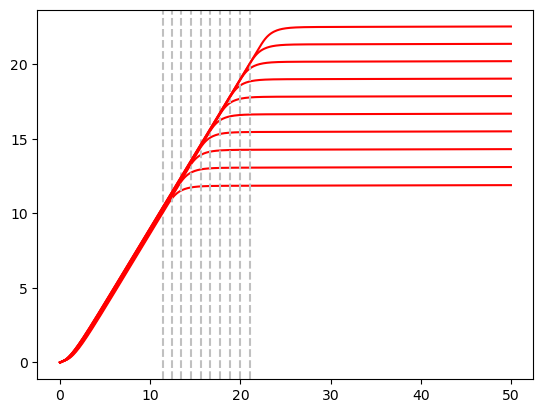

In [147]:

for n in np.linspace(10,20,10):
    TOLERANCE = n
    seekTOstr= n
    sol = solve_ivp(ode_system, t_span, y0, dense_output=True)
    t = np.linspace(0, 50, 500)
    y = sol.sol(t)
    time = np.linspace(0, 50, 500)
    y = sol.sol(t)
    seek = y[0]
    binge = y[1]
    stop = y[2]
    striatum = y[3]
    alc = y[4]
    setp = 1-F(Esetp*(alc-TOLERANCE))
    vta = F(vtaSLOPE * (t - (TOLERANCE/3)))
    #vta = F(vtaSLOPE * (t - (TOLERANCE / (Eaps * striatum)) * daFACTOR))

    for n in np.arange(len(alc)):
        if alc[n]>=TOLERANCE:
            thresh = time[n]
            break

    plt.axvline(x=thresh, color = 'silver',linestyle='dashed')
    plt.plot(time, alc, color = 'red')
plt.show()

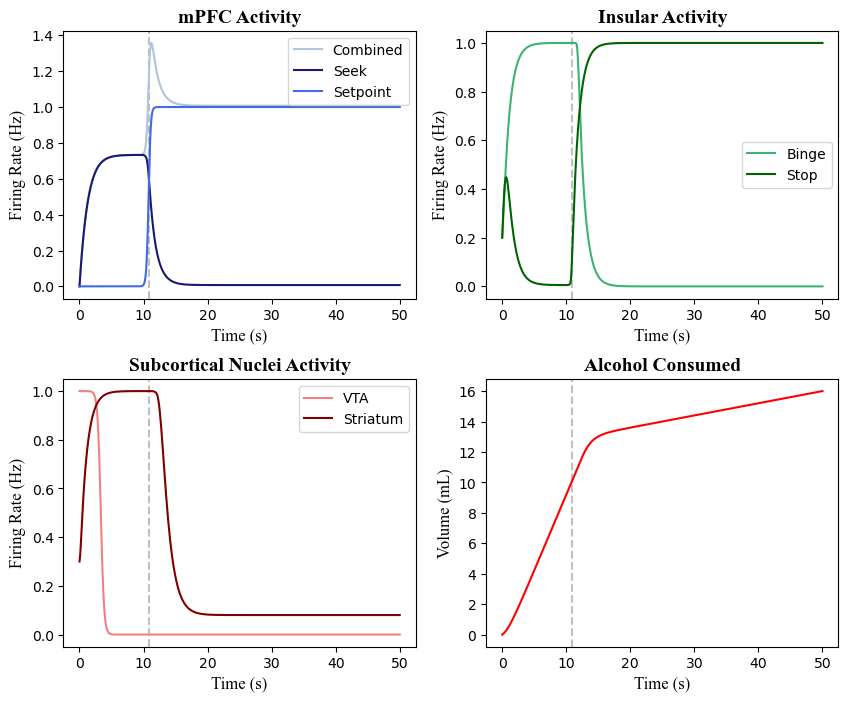

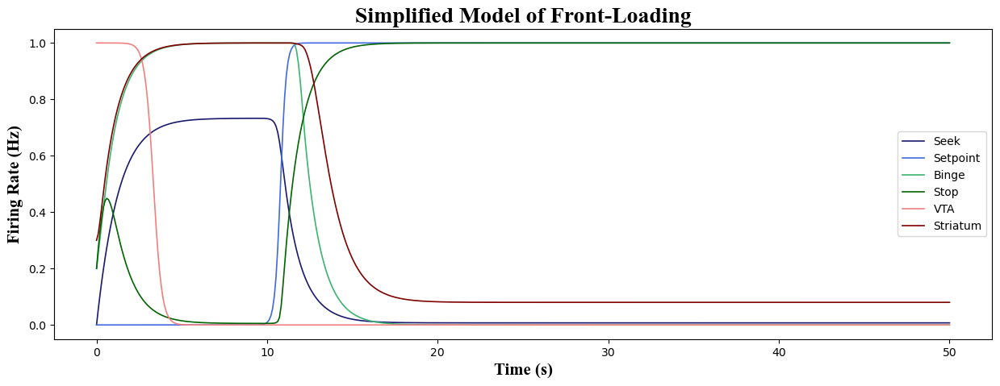

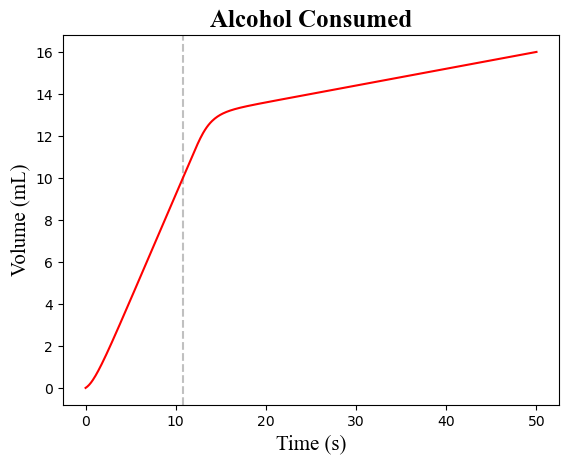

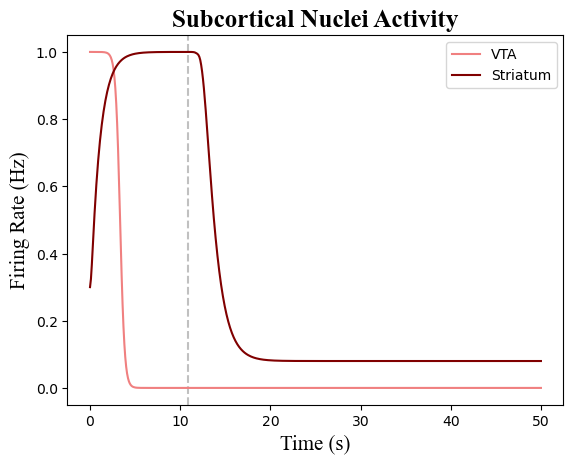

In [9]:
# Plotting the results

time = np.linspace(0, 50, 500)
y = sol.sol(t)
seek = y[0]
binge = y[1]
stop = y[2]
striatum = y[3]
alc = y[4]
setp = 1-F(Esetp*(alc-TOLERANCE))
vta = F(vtaSLOPE * (t - (TOLERANCE/3)))
#vta = F(vtaSLOPE * (t - (TOLERANCE / (Eaps * striatum)) * daFACTOR))

for n in np.arange(len(alc)):
    if alc[n]>=TOLERANCE:
        thresh = time[n]
        break
        
f, axs = plt.subplots(2, 2, figsize=(10, 8))

axs[0,0].axvline(x=thresh, color = 'silver',linestyle='dashed')
axs[0,0].plot(time, seek+setp, label = 'Combined', color = 'lightsteelblue')
axs[0,0].plot(time, seek, label = 'Seek', color = 'midnightblue')
axs[0,0].plot(time, setp, label = 'Setpoint', color = 'royalblue')
axs[0,0].set_title('mPFC Activity', **tfont, fontweight = 'bold', fontsize='14')
axs[0,0].set_ylabel('Firing Rate (Hz)',**tfont, fontsize='12')
axs[0,0].set_xlabel('Time (s)',**tfont, fontsize='12')
axs[0,0].legend()

axs[0,1].axvline(x=thresh, color = 'silver',linestyle='dashed')
axs[0,1].plot(time, binge, label ='Binge', color = 'mediumseagreen')
axs[0,1].plot(time, stop, label = 'Stop', color = 'darkgreen')
axs[0,1].set_title('Insular Activity',**tfont, fontweight = 'bold', fontsize='14')
axs[0,1].set_ylabel('Firing Rate (Hz)',**tfont, fontsize='12')
axs[0,1].set_xlabel('Time (s)',**tfont, fontsize='12')
axs[0,1].legend()

axs[1,0].axvline(x=thresh, color = 'silver',linestyle='dashed')
axs[1,0].plot(time, vta, label = 'VTA', color = 'lightcoral')
axs[1,0].plot(time,striatum, label = 'Striatum', color = 'maroon')
axs[1,0].set_title('Subcortical Nuclei Activity',**tfont, fontweight = 'bold', fontsize='14')
axs[1,0].set_ylabel('Firing Rate (Hz)',**tfont, fontsize='12')
axs[1,0].set_xlabel('Time (s)',**tfont, fontsize='12')
axs[1,0].legend()

axs[1,1].axvline(x=thresh, color = 'silver',linestyle='dashed')
axs[1,1].plot(time, alc, color = 'red')
axs[1,1].set_title('Alcohol Consumed',**tfont, fontweight = 'bold', fontsize='14')
axs[1,1].set_ylabel('Volume (mL)',**tfont, fontsize='12')
axs[1,1].set_xlabel('Time (s)',**tfont, fontsize='12')

plt.subplots_adjust(wspace=0.2, hspace=0.3)
plt.show()

plt.figure(figsize=(15,5))
plt.plot(time, seek, label = 'Seek', color = 'midnightblue', linewidth='1.2')
plt.plot(time,setp, label = 'Setpoint', color = 'royalblue', linewidth='1.2')
plt.plot(time, binge, label ='Binge', color = 'mediumseagreen', linewidth='1.2')
plt.plot(time, stop, label = 'Stop', color = 'darkgreen', linewidth='1.2')
plt.plot(time, vta, label = 'VTA', color = 'lightcoral', linewidth='1.2')
plt.plot(time,striatum, label = 'Striatum', color = 'maroon', linewidth='1.2')
plt.xlabel('Time (s)',**tfont, fontsize='15',fontweight = 'bold')
plt.ylabel('Firing Rate (Hz)',**tfont, fontsize='15',fontweight = 'bold')
plt.legend()
plt.title('Simplified Model of Front-Loading',**tfont, fontweight = 'bold', fontsize='20')

plt.show()

plt.axvline(x=thresh, color = 'silver',linestyle='dashed')
plt.plot(time, alc, color = 'red')
plt.title('Alcohol Consumed',**tfont, fontweight = 'bold', fontsize='18')
plt.ylabel('Volume (mL)',**tfont, fontsize='15')
plt.xlabel('Time (s)',**tfont, fontsize='15')

plt.show()

plt.axvline(x=thresh, color = 'silver',linestyle='dashed')


plt.plot(time, vta, label = 'VTA', color = 'lightcoral')
plt.plot(time,striatum, label = 'Striatum', color = 'maroon')
plt.title('Subcortical Nuclei Activity',**tfont, fontweight = 'bold', fontsize='18')
plt.ylabel('Firing Rate (Hz)',**tfont, fontsize='15')
plt.xlabel('Time (s)',**tfont, fontsize='15')
plt.legend()


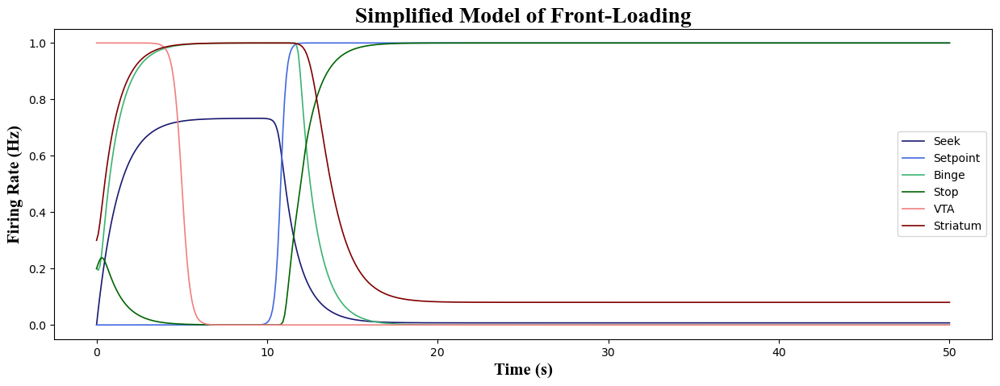

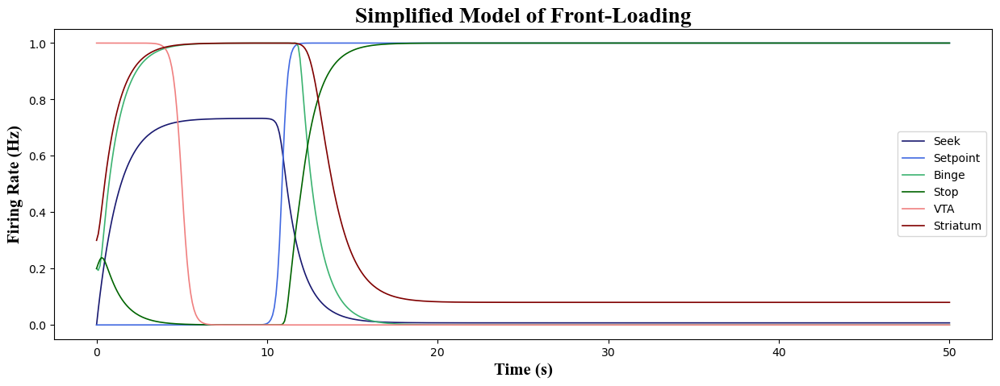

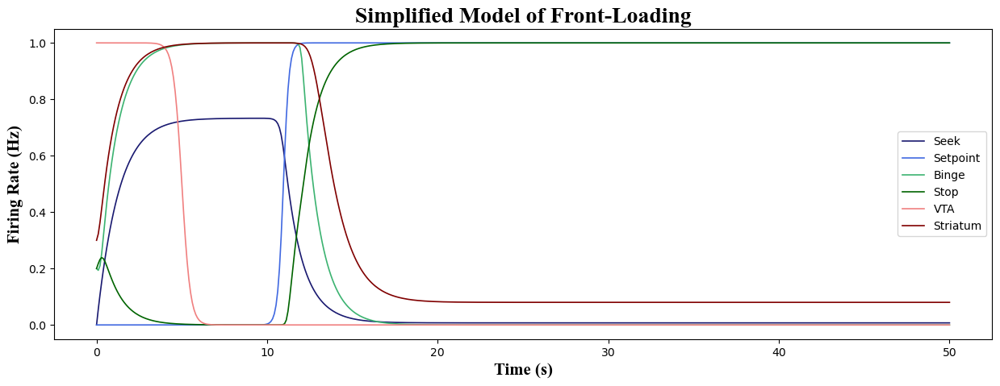

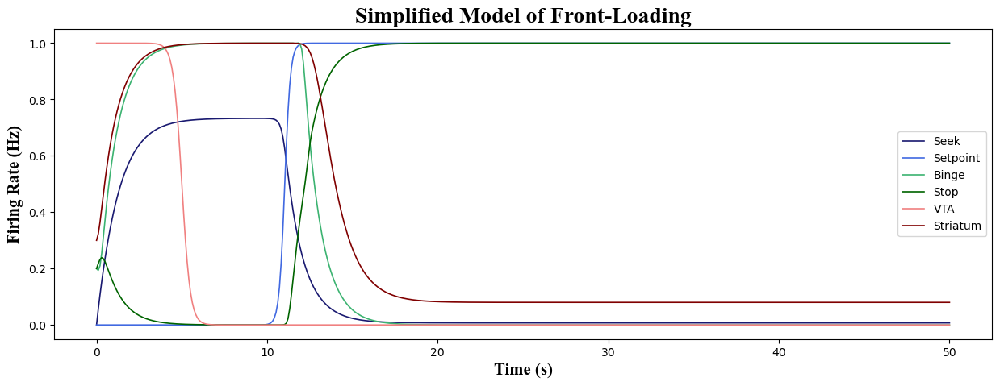

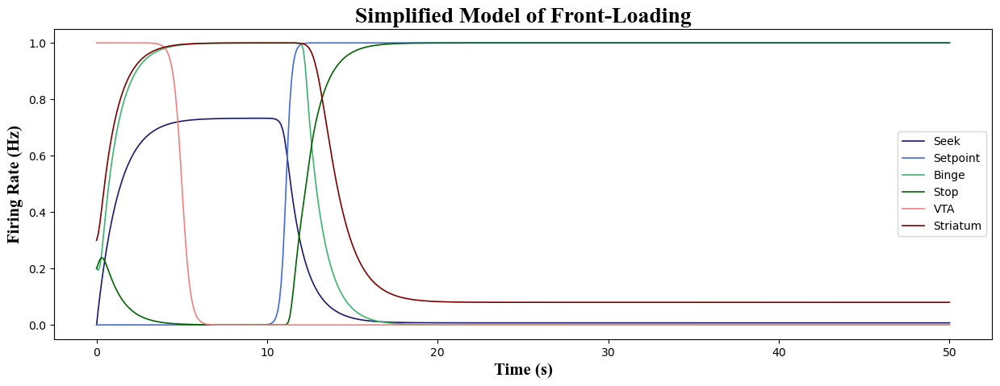

...

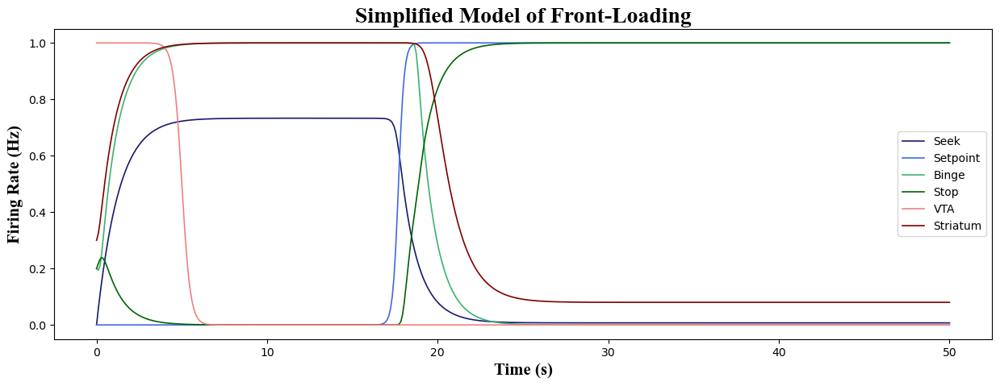

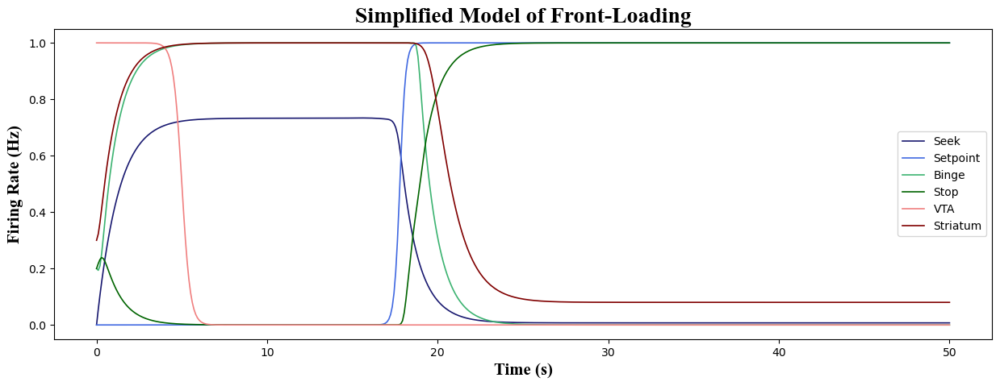

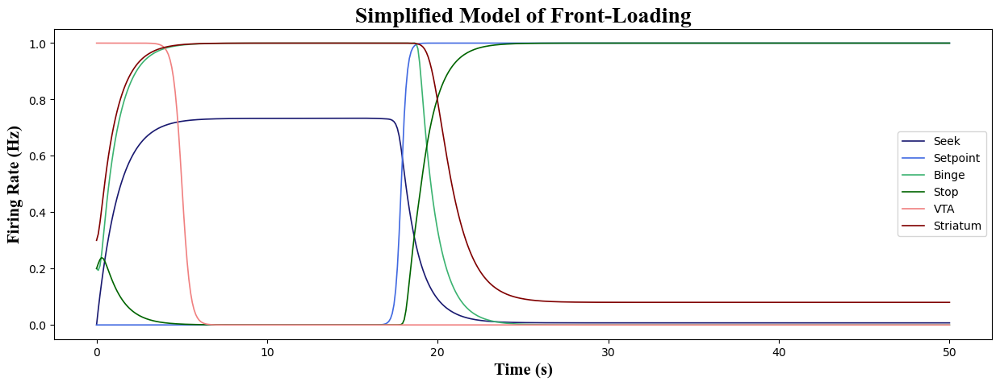

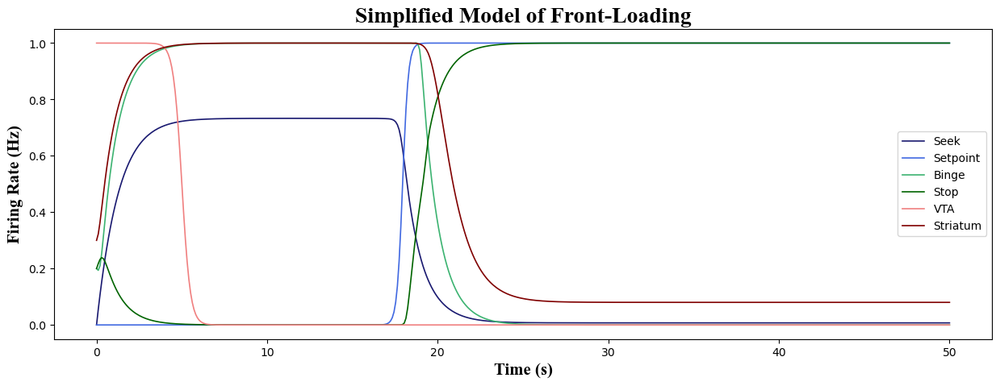

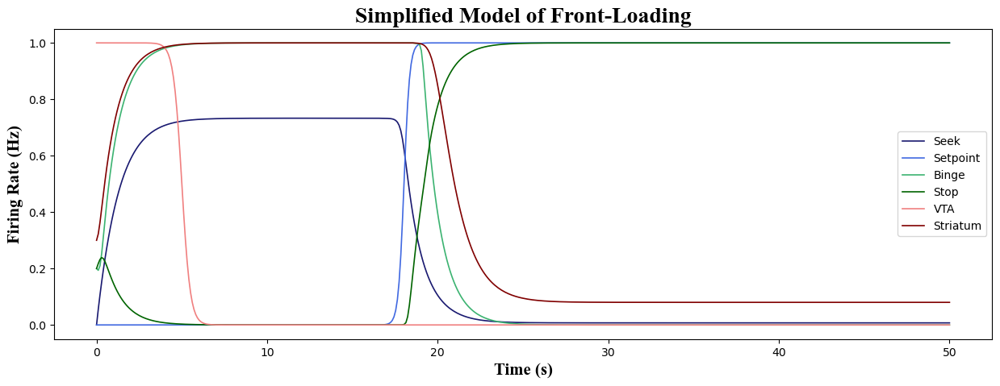

/var/folders/vw/0t6vz1wn6rn5mgpcy6w188x00000gn/T/ipykernel_23038/70655807.py:3: RuntimeWarning: overflow encountered in exp
  return 1 / (1 + np.exp(x))


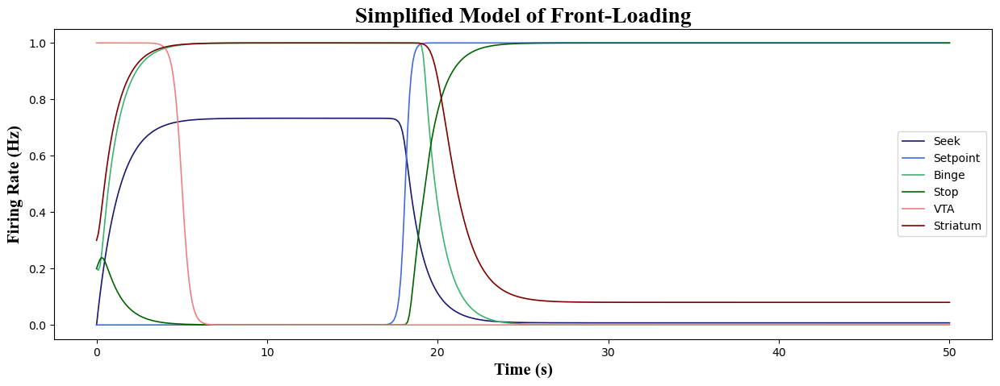

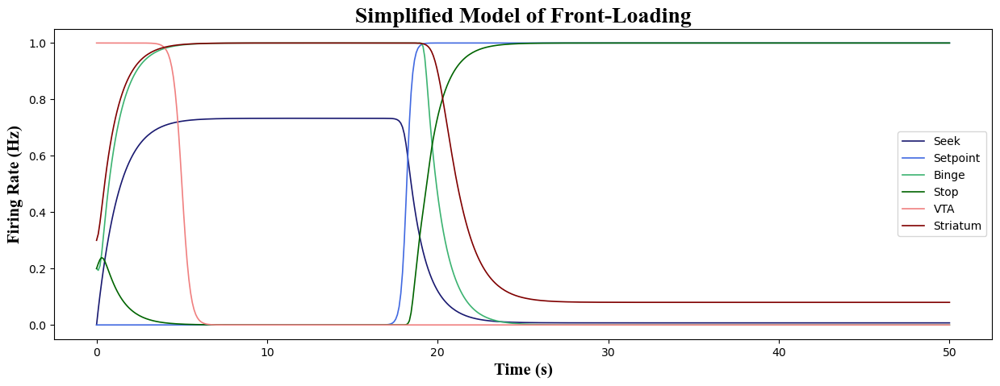

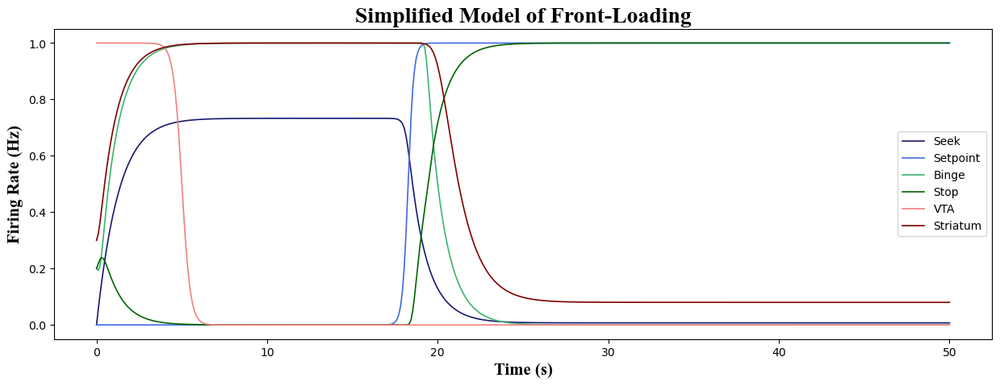

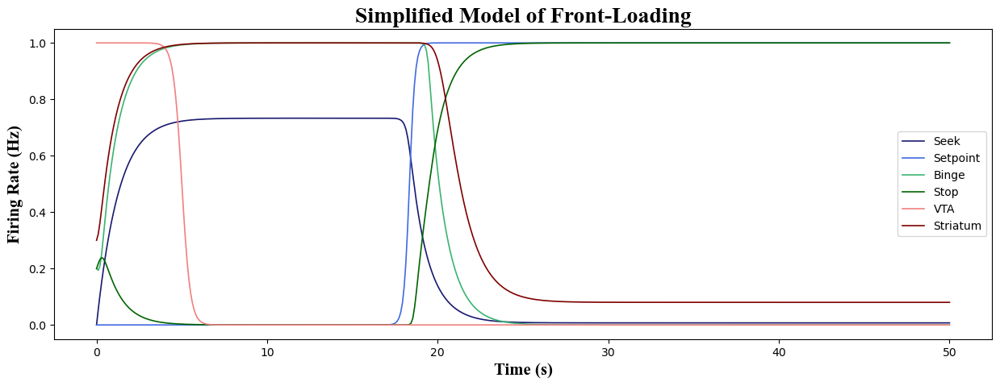

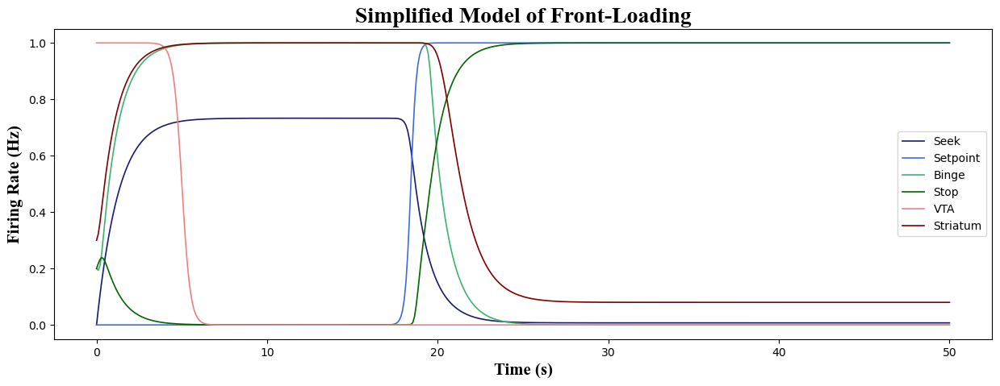

...

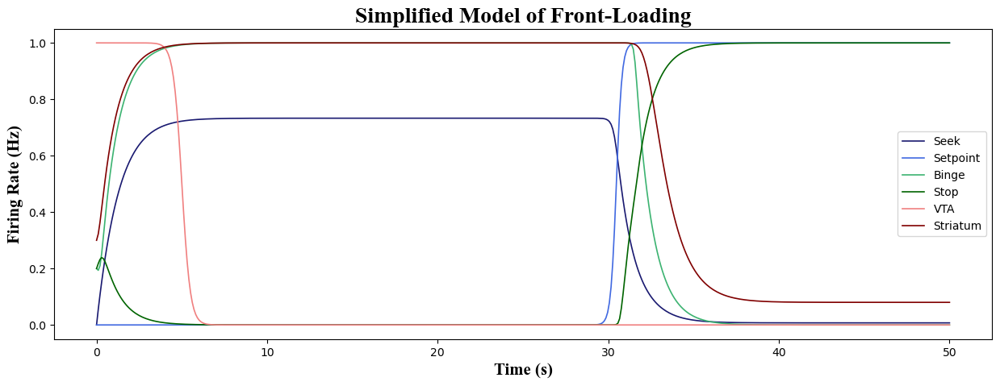

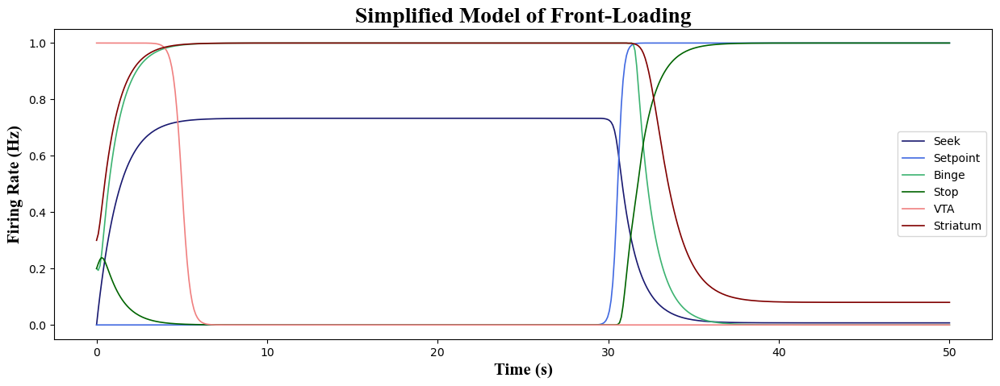

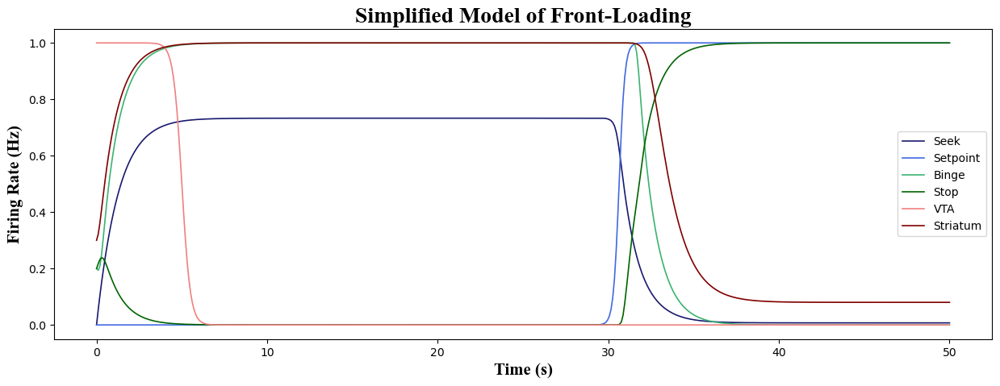

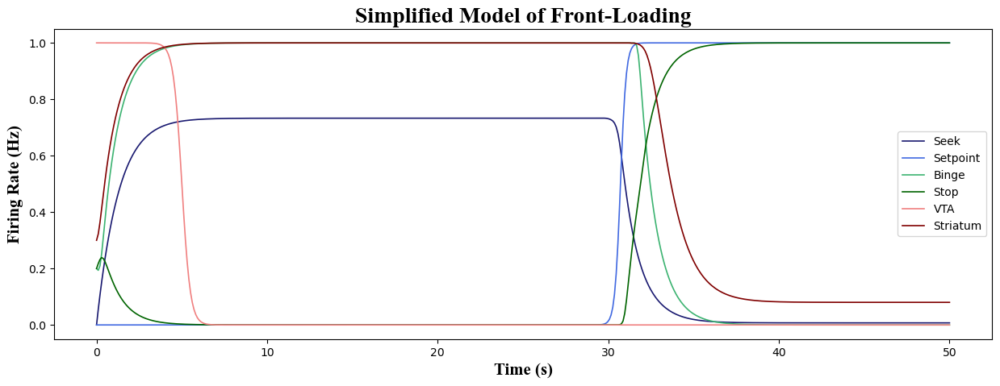

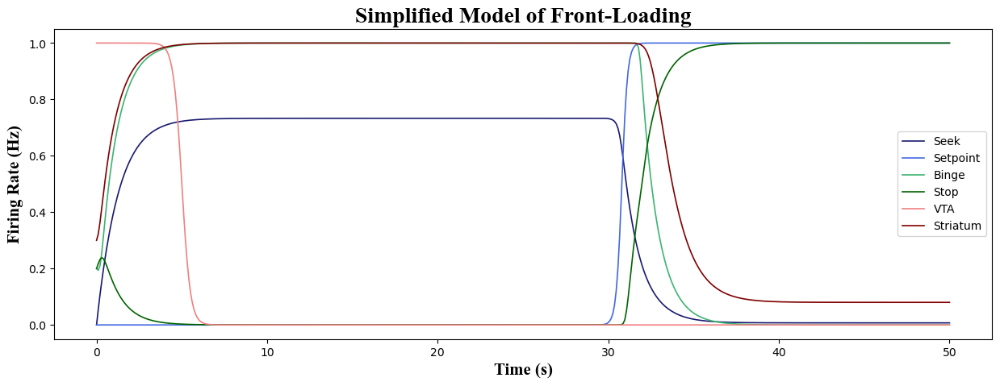

In [112]:
#Making an animation
z=0
for n in np.linspace(10,30,250):
    TOLERANCE = n
    sol = solve_ivp(ode_system, t_span, y0, dense_output=True)
    time = np.linspace(0, 50, 500)
    y = sol.sol(t)
    seek = y[0]
    binge = y[1]
    stop = y[2]
    striatum = y[3]
    alc = y[4]
    setp = 1-F(Esetp*(alc-TOLERANCE))
    vta = F(vtaSLOPE * (t - (5)))

    for i in np.arange(len(alc)):
        if alc[i]>=TOLERANCE:
            thresh = time[i]
            break
            
    plt.figure(figsize=(15,5))
    plt.plot(time, seek, label = 'Seek', color = 'midnightblue', linewidth='1.2')
    plt.plot(time,setp, label = 'Setpoint', color = 'royalblue', linewidth='1.2')
    plt.plot(time, binge, label ='Binge', color = 'mediumseagreen', linewidth='1.2')
    plt.plot(time, stop, label = 'Stop', color = 'darkgreen', linewidth='1.2')
    plt.plot(time, vta, label = 'VTA', color = 'lightcoral', linewidth='1.2')
    plt.plot(time,striatum, label = 'Striatum', color = 'maroon', linewidth='1.2')
    plt.xlabel('Time (s)',**tfont, fontsize='15',fontweight = 'bold')
    plt.ylabel('Firing Rate (Hz)',**tfont, fontsize='15',fontweight = 'bold')
    plt.legend()
    plt.title('Simplified Model of Front-Loading',**tfont, fontweight = 'bold', fontsize='20')
    z=z+1
    tol = str(z)
    plt.savefig(''+tol+'')
    plt.show()


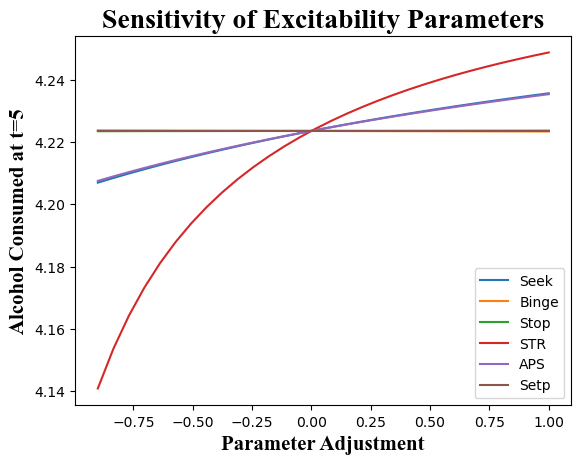

In [159]:
## Sensitvity Testing
param = np.linspace(-0.9,1,30)

# Eseek (1)
Eseek_sen = []
for n in param:
    Eseek = 1 + n
    sol_sen = solve_ivp(ode_system, t_span, y0, dense_output=True)
    y=sol_sen.sol(t)
    sen = y[4,50]
    Eseek_sen.append(sen)
Eseek = 1

# Ebinge (10.5)
Ebinge_sen = []
for n in param:
    Ebinge = 10.5 + n
    sol_sen = solve_ivp(ode_system, t_span, y0, dense_output=True)
    y=sol_sen.sol(t)
    sen = y[4,50]
    Ebinge_sen.append(sen)
Ebinge = 10.5


#Estop (10.5)
Estop_sen = []
for n in param:
    Estop = 10.5 + n
    sol_sen = solve_ivp(ode_system, t_span, y0, dense_output=True)
    y=sol_sen.sol(t)
    sen = y[4,50]
    Estop_sen.append(sen)
Estop = 10.5

#Estr (1.84)
Estr_sen = []
for n in param:
    Estr = 1.84 + n
    sol_sen = solve_ivp(ode_system, t_span, y0, dense_output=True)
    y=sol_sen.sol(t)
    sen = y[4,50]
    Estr_sen.append(sen)
Estr = 1.84

#Eaps (1)
Eaps_sen = []
for n in param:
    Eaps = 1 + n
    sol_sen = solve_ivp(ode_system, t_span, y0, dense_output=True)
    y=sol_sen.sol(t)
    sen = y[4,50]
    Eaps_sen.append(sen)
Eaps = 1


#Esetp (6)
Esetp_sen = []
for n in param:
    Esetp = 6 + n
    sol_sen = solve_ivp(ode_system, t_span, y0, dense_output=True)
    y=sol_sen.sol(t)
    sen = y[4,50]
    Esetp_sen.append(sen)
Esetp = 6

plt.plot(param, Eseek_sen, label = 'Seek')
plt.plot(param, Ebinge_sen, label='Binge')
plt.plot(param, Estop_sen, label = 'Stop')
plt.plot(param, Estr_sen, label = 'STR')
plt.plot(param, Eaps_sen, label = 'APS')
plt.plot(param, Esetp_sen, label = 'Setp')
plt.xlabel('Parameter Adjustment', **tfont, fontsize = 15, fontweight='bold')
plt.ylabel('Alcohol Consumed at t=5', **tfont, fontsize = 15, fontweight='bold')
plt.title('Sensitivity of Excitability Parameters', **tfont, fontsize = 20, fontweight='bold')
plt.legend()


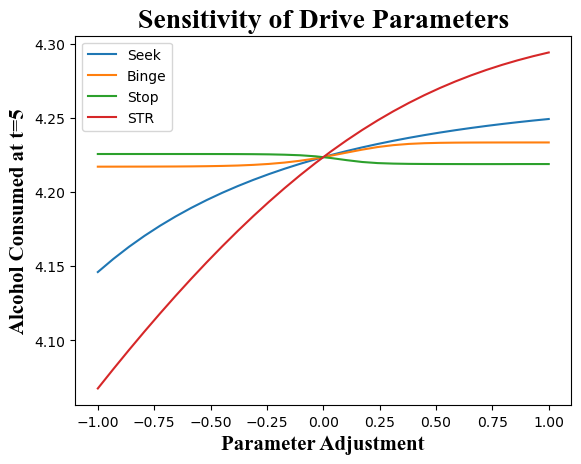

In [160]:
## Sensitvity Testing
param = np.linspace(-1,1,30)

# Seek Drive (0.01)
seek_sen = []
for n in param:
    seekDRIVE = 0.01 + n
    sol_sen = solve_ivp(ode_system, t_span, y0, dense_output=True)
    y=sol_sen.sol(t)
    sen = y[4,50]
    seek_sen.append(sen)
seekDRIVE = 0.01

# Binge Drive (0.15)
binge_sen = []
for n in param:
    bingeDRIVE = 0.15 + n
    sol_sen = solve_ivp(ode_system, t_span, y0, dense_output=True)
    y=sol_sen.sol(t)
    sen = y[4,50]
    binge_sen.append(sen)
bingeDRIVE = 0.15

# stop Drive (0.15)
stop_sen = []
for n in param:
    stopDRIVE = 0.15 + n
    sol_sen = solve_ivp(ode_system, t_span, y0, dense_output=True)
    y=sol_sen.sol(t)
    sen = y[4,50]
    stop_sen.append(sen)
stopDRIVE = 0.15

# STR Drive (-1.4)
str_sen = []
for n in param:
    strDRIVE = -1.4 + n
    sol_sen = solve_ivp(ode_system, t_span, y0, dense_output=True)
    y=sol_sen.sol(t)
    sen = y[4,50]
    str_sen.append(sen)
strDRIVE = -1.4

plt.plot(param, seek_sen, label = 'Seek')
plt.plot(param, binge_sen, label='Binge')
plt.plot(param, stop_sen, label = 'Stop')
plt.plot(param, str_sen, label = 'STR')
plt.xlabel('Parameter Adjustment', **tfont, fontsize = 15, fontweight='bold')
plt.ylabel('Alcohol Consumed at t=5', **tfont, fontsize = 15, fontweight='bold')
plt.title('Sensitivity of Drive Parameters', **tfont, fontsize = 20, fontweight='bold')
plt.legend()


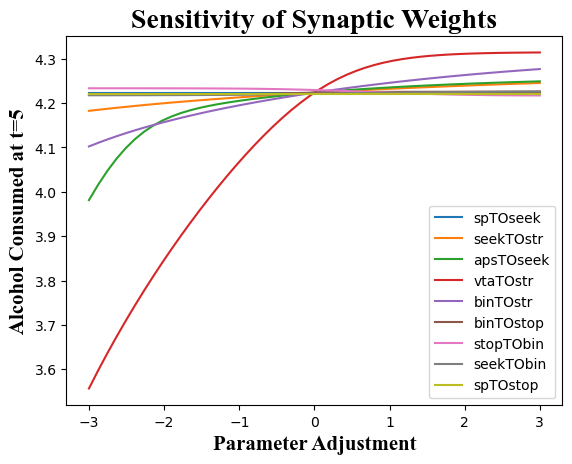

In [161]:
## Sensitvity Testing
param = np.linspace(-3,3,50)

# spTOseek (5)
spTOseek_sen = []
for n in param:
    spTOseek = 5 + n
    sol_sen = solve_ivp(ode_system, t_span, y0, dense_output=True)
    y=sol_sen.sol(t)
    sen = y[4,50]
    spTOseek_sen.append(sen)
spTOseek = 5

# seekTOstr (10)
seekTOstr_sen = []
for n in param:
    seekTOstr = 10 + n
    sol_sen = solve_ivp(ode_system, t_span, y0, dense_output=True)
    y=sol_sen.sol(t)
    sen = y[4,50]
    seekTOstr_sen.append(sen)
seekTOstr = 10

# apsTOseek (1)
apsTOseek_sen = []
for n in param:
    apsTOseek = 1 + n
    sol_sen = solve_ivp(ode_system, t_span, y0, dense_output=True)
    y=sol_sen.sol(t)
    sen = y[4,50]
    apsTOseek_sen.append(sen)
apsTOseek = 1

# vtaTOstr (1)
vtaTOstr_sen = []
for n in param:
    vtaTOstr = 1 + n
    sol_sen = solve_ivp(ode_system, t_span, y0, dense_output=True)
    y=sol_sen.sol(t)
    sen = y[4,50]
    vtaTOstr_sen.append(sen)
vtaTOstr = 1

# binTOstr (1)
binTOstr_sen = []
for n in param:
    binTOstr = 1 + n
    sol_sen = solve_ivp(ode_system, t_span, y0, dense_output=True)
    y=sol_sen.sol(t)
    sen = y[4,50]
    binTOstr_sen.append(sen)
binTOstr = 1

# binTOstop (1)
binTOstop_sen = []
for n in param:
    binTOstop = 1 + n
    sol_sen = solve_ivp(ode_system, t_span, y0, dense_output=True)
    y=sol_sen.sol(t)
    sen = y[4,50]
    binTOstop_sen.append(sen)
binTOstop = 1

# stopTObin (2)
stopTObin_sen = []
for n in param:
    stopTObin = 1 + n
    sol_sen = solve_ivp(ode_system, t_span, y0, dense_output=True)
    y=sol_sen.sol(t)
    sen = y[4,50]
    stopTObin_sen.append(sen)
stopTObin = 2

# seekTObin (2)
seekTObin_sen = []
for n in param:
    seekTObin = 2 + n
    sol_sen = solve_ivp(ode_system, t_span, y0, dense_output=True)
    y=sol_sen.sol(t)
    sen = y[4,50]
    seekTObin_sen.append(sen)
seekTObin = 2

# spTOstop (2)
spTOstop_sen = []
for n in param:
    spTOstop = 1 + n
    sol_sen = solve_ivp(ode_system, t_span, y0, dense_output=True)
    y=sol_sen.sol(t)
    sen = y[4,50]
    spTOstop_sen.append(sen)
spTOstop = 1

plt.plot(param, spTOseek_sen, label = 'spTOseek')
plt.plot(param, seekTOstr_sen, label = 'seekTOstr')
plt.plot(param, apsTOseek_sen, label = 'apsTOseek')
plt.plot(param, vtaTOstr_sen, label = 'vtaTOstr')
plt.plot(param, binTOstr_sen, label = 'binTOstr')
plt.plot(param, binTOstop_sen, label = 'binTOstop')
plt.plot(param, stopTObin_sen, label = 'stopTObin')
plt.plot(param, seekTObin_sen, label = 'seekTObin')
plt.plot(param, spTOstop_sen, label = 'spTOstop')

plt.xlabel('Parameter Adjustment', **tfont, fontsize = 15, fontweight='bold')
plt.ylabel('Alcohol Consumed at t=5', **tfont, fontsize = 15, fontweight='bold')
plt.title('Sensitivity of Synaptic Weights', **tfont, fontsize = 20, fontweight='bold')
plt.legend()
